# 1.. Lets Read data for Analysis

In [1]:
### lets import all the necessary packages !

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

In [2]:
import os

In [3]:
os.listdir(r"F:\Data Analysis_projects_datasets\Uber\Datasets")

['other-American_B01362.csv',
 'other-Carmel_B00256.csv',
 'other-Dial7_B00887.csv',
 'other-Diplo_B01196.csv',
 'other-Federal_02216.csv',
 'other-FHV-services_jan-aug-2015.csv',
 'other-Firstclass_B01536.csv',
 'other-Highclass_B01717.csv',
 'other-Lyft_B02510.csv',
 'other-Prestige_B01338.csv',
 'other-Skyline_B00111.csv',
 'Uber-Jan-Feb-FOIL.csv',
 'uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-janjune-15.csv',
 'uber-raw-data-janjune-15_sample.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [ ]:
'''
1 ) "uber-raw-data-janjune-15.csv" ->> this data contains all the 
    entries/pickups from 'January' to 'June'
    Quite huge dataset having approx 15M data pts , so lets consider
    its sample which have approx 1M


2 ) "uber-raw-data-janjune-15_sample.csv" ->> this data is a sample 
    of "uber-raw-data-janjune-15.csv"
    'Since above data is quite huge ~15 Million , hence it is good 
    to work with some sample if u do not have good specifications systems



3 ) "Uber-Jan-Feb-FOIL.csv" ->> this data contains these features ::


dispatching base_no : base_number of vehicle 

        The Base codes are for the following Uber bases:
            B02512 : Unter
            B02598 : Hinter
            B02617 : Weiter
            B02682 : Schmecken
            B02764 : Danach-NY
            
Date :                date on which all these trips have happened 
active_vehicles :     total active_vehicles 
trips :               no of trips this base number have done 




4 ) Later-on while doing Data collection , we will consider rest of 
    the datasets as well..
    Specially:   'uber-raw-data-apr14.csv',
                 'uber-raw-data-aug14.csv',
                 'uber-raw-data-jul14.csv',
                 'uber-raw-data-jun14.csv',
                 'uber-raw-data-may14.csv',
                 'uber-raw-data-sep14.csv'


'''

In [4]:
## lets read  "Uber-Jan-Feb-FOIL.csv"..
uber_foil = pd.read_csv(r'F:\Data Analysis_projects_datasets\Uber\
                            Datasets/Uber-Jan-Feb-FOIL.csv')

In [4]:
## read data (takes 5-10 sec )
uber_15 = pd.read_csv(r'F:\Data Analysis_projects_datasets\Uber\
   Datasets/uber-raw-data-janjune-15_sample.csv', encoding='utf-8')

In [29]:
## uber_15.sample(100000).to_csv(r'F:\Data Analysis_projects_datasets\Uber\Datasets\uber-raw-data-janjune-15_sample.csv',  index=False)

In [5]:
## view of data
uber_15.head(2)

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID
0,B02617,2015-05-02 21:43:00,B02764,237
1,B02682,2015-01-20 19:52:59,B02682,231


In [6]:
## getting dimensions of data
uber_15.shape

(100000, 4)

## 2.. Lets Perform Data pre-processing/Data cleaning !
        check data-type , check missing values , check whether 
        duplicated values or not !, ie Prepare Data for Analysis !

In [7]:
## getting count of total duplicated observations in your data 
uber_15.duplicated().sum()

54

In [8]:
## deleting all the duplicated observations 
uber_15.drop_duplicates(inplace=True)

In [9]:
uber_15.shape

(99946, 4)

In [10]:
### what about data-type of your features
uber_15.dtypes

Dispatching_base_num    object
Pickup_date             object
Affiliated_base_num     object
locationID               int64
dtype: object

In [11]:
uber_15.isnull().sum() 
## we will deal with missing values 
## later if needed as only 1 feature have most no of missing values ..

Dispatching_base_num       0
Pickup_date                0
Affiliated_base_num     1116
locationID                 0
dtype: int64

    we can see that "Pickup_date" is a object data type,
    Therefore,we have to convert this datatype into datetime bcz 
    at the end we have to extract couple of Derived attributes.

    For this we require pandas to_datetime to convert object data 
    type to datetime dtype..

In [12]:
uber_15['Pickup_date'][0]

'2015-05-02 21:43:00'

In [13]:
uber_15['Pickup_date'] = pd.to_datetime(uber_15['Pickup_date'],\
                                format ='%Y-%m-%d %H:%M:%S' ) 

In [14]:
uber_15['Pickup_date'][0]

Timestamp('2015-05-02 21:43:00')

In [15]:
uber_15['Pickup_date'].dtype

dtype('<M8[ns]')

In [16]:
### what about data-type of your features
uber_15.dtypes

Dispatching_base_num            object
Pickup_date             datetime64[ns]
Affiliated_base_num             object
locationID                       int64
dtype: object

In [ ]:
'''
datetime64[ns] is a general dtype, while <M8[ns] is a specific 
dtype , ns is basicaly nano second..
Both are similar , it entirely how your numpy was compiled..

np.dtype('datetime64[ns]') == np.dtype('<M8[ns]')
## True


'''

In [ ]:
'''
Categorical data has : Object & bool data-types 
Numerical data have : Integer & Float data-type

'''

In [ ]:
'''

Categorical data refers to a data type that can be stored 
into groups/categories/labels 

Examples of categorical variables are age group, 
educational level,blood type etc.. 


Numerical data refers to the data that is in the form of numbers, 
Examples of numerical data are height, weight, age etc.. 

Numerical data has two categories: discrete data and continuous data


Discrete data : It basically takes countable numbers like 
                1, 2, 3, 4, 5, and so on. 
                In case of infinity, these numbers will keep going on...
                age of a fly : 8 , 9 day etc..
                
Continuous data : which is continuous in nature 
                  amount of sugar , 11.2 kg  , 
                  temp of a city  , your bank balance !
                  
For example, salary levels and performance classifications 
are discrete variables, whereas height and weight are continuous variables.

'''

In [ ]:
'''

Variations of int are : ('int64','int32','int16') in numpy library..
By the way , all the variations of signed integers comes 
sub-class numpy.signedinteger

Int16 is a 16 bit signed integer , it means it can store both 
positive & negative values
int16 has has a range of  (2^15 − 1) to -2^15 
int16 has a length of 16 bits (2 bytes).. ie Int16 uses 16 bits 


Int32 is a 32 bit signed integer , it means it stores both 
positive & negative values
int32 has has a range of (2³¹ − 1) to  -2^31
int32 has a length of 32 bits (4 bytes),, ie Int32 uses 32 bits


Int64 is a 64 bit signed integer , it means it can store both 
positive & negative values
int64 has has a range of  (2^63 − 1) to -2^63 
int64 has a length of 64 bits (8 bytes) , ie Int64 uses 64 bits.
             

The only difference is that int64 has max range of storing numbers 
, then comes int32 , then 16 , then int8

That means that Int64’s take up twice as much memory-and doing 
operations on them may be a lot slower in some machine architectures.

However, Int64’s can represent numbers much more accurately than 
32 bit floats.They also allow much larger numbers to be stored..

'''




'''
Variations of float are :('float64','float32','float16') in 
numpy library..
By the way , all the variations of signed integers comes 
sub-class numpy.floating

Float16 is a 16-bit number ie it uses/occupies 16 bits in 
computer memory to store decimal number 
    (Also known as Half-precision floating-point format)
    
Float32 is a 32 bit number ie it uses/occupies 32 bits in 
computer memory to store decimal number 
    (Also known as Single-precision floating-point format)
    
Float64 is a 64 bit number ie it uses/occupies 64 bits in 
computer memory to store decimal number 
    (Also known as Double-precision floating-point format)


That means that float64’s take up twice as much memory-and doing 
operations on them may be a lot slower in some machine architectures.

However, float64’s can represent numbers much more accurately than 
32 bit floats.They also allow much larger numbers to be stored..



Note : Let say for float64 , If we will try to store a string 
value in float, or a decimal beyond what can be made using 64-bits,
the program will either return an overflow error or return
a rounded-off value of the original 

'''


In [ ]:
'''

Variations of unsigned integer are : 
('uint64','uint32','uint16','uint8') in numpy library..
By the way , all the variations of signed integers 
comes sub-class numpy.unsignedinteger

uint8 is a 8 bit un-signed integer , it means it 
can store only positive values
Range->> Integer values from (0 to 255) ie [0 to 2^8 -1]
uint8 has a length of 8 bits (1 bytes). 

uint16 is a 16 bit un-signed integer , it means it can 
store only positive values
Range->> Integer values from (0 to 65535) ie [0 to 2^16 -1]
uint16 has a length of 16 bits (2 bytes).


uint32 is a 32 bit un-signed integer , it means it can 
store only positive values
Range->> Integer values from (0 to 4294967295) ie [0 to 2^32 -1]
uint32 has a length of 32 bits (4 bytes).


uint64 is a 64 bit un-signed integer , it means it can 
store only positive values
Range->> Integer values from (0 to 18446744073709551615) ie 
[0 to 2^64 -1]
uint64 has a length of 64 bits (8 bytes).


'''

In [17]:
uber_15.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 99946 entries, 0 to 99999
Data columns (total 4 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   Dispatching_base_num  99946 non-null  object        
 1   Pickup_date           99946 non-null  datetime64[ns]
 2   Affiliated_base_num   98830 non-null  object        
 3   locationID            99946 non-null  int64         
dtypes: datetime64[ns](1), int64(1), object(2)
memory usage: 5.8+ MB


In [ ]:
'''

3 features belong to object data-type , ie.. in context to Python ,
they belong to string data-type
Object : dtype NumPy array.. 
            ie it can hold "string" + 
            any_python_object[integer ,float , string] in a feature 
            
            pd.Series(["shan", "rahul", 2]) 
            ->> will have dtype as "Object"
            
1 feature belong to int64 nature  , ie 
Variations of int are : ('int64','int32','int16') in numpy library..





The memory usage of a DataFrame (including the index) is shown
when calling the info(). 
A configuration option, display.memory_usage (see the list of options),
specifies if the DataFrame’s memory usage will be displayed 
when invoking the df.info() method..
 
 
The + symbol indicates that the true memory usage could be higher, 
because pandas does not count the memory used by values 
in columns with dtype=object


Passing memory_usage='deep' will enable a more accurate memory usage report .

'''

In [18]:
uber_15.info(memory_usage='deep')

<class 'pandas.core.frame.DataFrame'>
Int64Index: 99946 entries, 0 to 99999
Data columns (total 4 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   Dispatching_base_num  99946 non-null  object        
 1   Pickup_date           99946 non-null  datetime64[ns]
 2   Affiliated_base_num   98830 non-null  object        
 3   locationID            99946 non-null  int64         
dtypes: datetime64[ns](1), int64(1), object(2)
memory usage: 16.3 MB


# 3.. Which month have max. Uber pickups in New York City ?

In [ ]:
## uber_15['Pickup_date'].dt.month ->> This gives month as 
## "1,2,3,4" not as "Jan Feb March Apr"

In [19]:
## extracting month-name from 'Pickup_date'..
uber_15['month'] = uber_15['Pickup_date'].dt.month_name()

<AxesSubplot:>

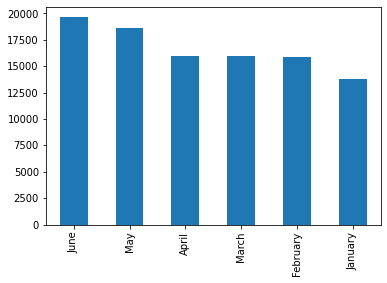

In [20]:
uber_15['month'].value_counts().plot(kind='bar')

### 3(b).. Lets Find out Total trips for each month & each weekdays.. 

In [21]:
## extracting dervied features (weekday ,day ,hour ,
## month ,minute) from 'Pickup_date'..

uber_15['weekday'] = uber_15['Pickup_date'].dt.day_name()
uber_15['day'] = uber_15['Pickup_date'].dt.day
uber_15['hour'] = uber_15['Pickup_date'].dt.hour
uber_15['minute'] = uber_15['Pickup_date'].dt.minute

In [22]:
uber_15.head(2)

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID,month,weekday,day,hour,minute
0,B02617,2015-05-02 21:43:00,B02764,237,May,Saturday,2,21,43
1,B02682,2015-01-20 19:52:59,B02682,231,January,Tuesday,20,19,52


In [23]:
pd.crosstab(index=uber_15['month'] , \
            columns=uber_15['weekday'])

weekday,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday
month,,,,,,,
April,2365,1833,2508,2052,2823,1880,2521
February,2655,1970,2550,2183,2396,2129,2013
January,2508,1353,2745,1651,2378,1444,1740
June,2793,2848,3037,2485,2767,3187,2503
March,2465,2115,2522,2379,2093,2388,2007
May,3262,1865,3519,2944,2627,2115,2328


In [24]:
pivot = pd.crosstab(index=uber_15['month'] , \
                    columns=uber_15['weekday'])

In [25]:
pivot

weekday,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday
month,,,,,,,
April,2365,1833,2508,2052,2823,1880,2521
February,2655,1970,2550,2183,2396,2129,2013
January,2508,1353,2745,1651,2378,1444,1740
June,2793,2848,3037,2485,2767,3187,2503
March,2465,2115,2522,2379,2093,2388,2007
May,3262,1865,3519,2944,2627,2115,2328


In [26]:
type(pivot)

pandas.core.frame.DataFrame

In [ ]:
'''
Since we have created grouped-bar chart using Seaborn in 
Amazon 4th problem statement , 
so let me show you how to build grouped bar chart using Pandas

'''

<AxesSubplot:xlabel='month'>

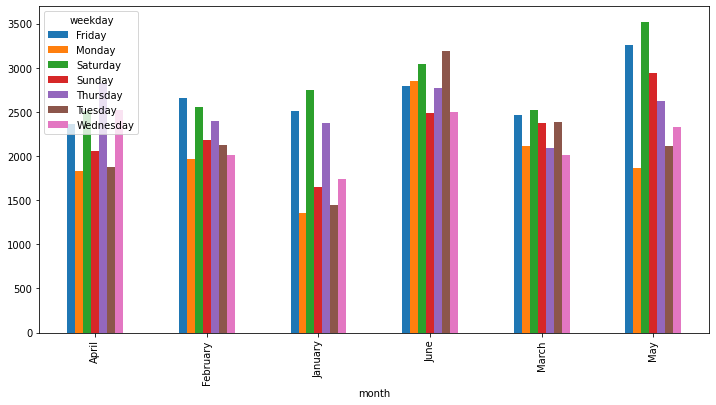

In [34]:
## create grouped bar chart using Pandas ..

pivot.plot(kind='bar' , figsize=(12,6))

# 4.. Lets Find out Hourly Rush in New york city on all days

In [35]:
summary = uber_15.groupby(['weekday','hour'],\
                          as_index=False).size()

In [36]:
summary

,weekday,hour,size
0,Friday,0,581
1,Friday,1,333
2,Friday,2,197
3,Friday,3,138
4,Friday,4,161
...,...,...,...
163,Wednesday,19,1044
164,Wednesday,20,897
165,Wednesday,21,949
166,Wednesday,22,900


<AxesSubplot:xlabel='hour', ylabel='size'>

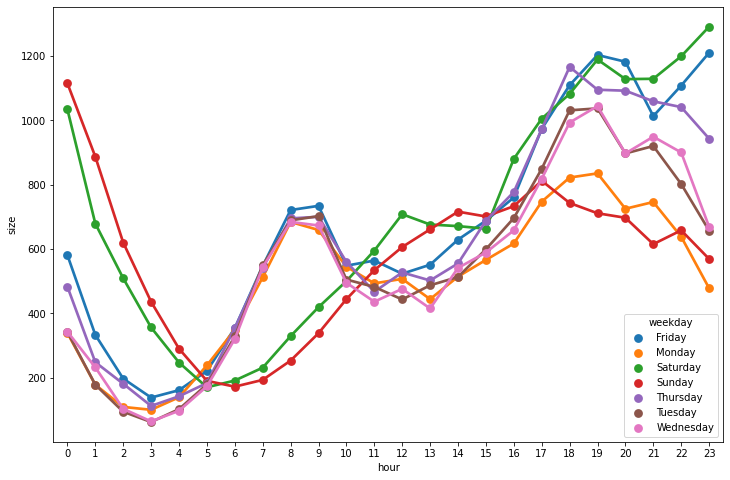

In [37]:
## pointplot between 'hour' & 'size' for all the weekdays..

plt.figure(figsize=(12,8))
sns.pointplot(x='hour',y='size',hue='weekday',data=summary)

In [26]:
'''
It's interesting to see that Saturday and Sunday exhibit 
similar demand throughout the late night/morning/afternoon, 
but it exhibits opposite trends during the evening. 
In the evening, Saturday pickups continue to increase throughout the evening,
but Sunday pickups takes a downward turn after evening..

We can see that there the weekdays that has the most 
demand during the late evening is Friday and Saturday, 
which is expected, but what strikes me is that 
Thursday nights also exhibits very similar trends as Friday and Saturday nights.

It seems like New Yorkers are starting their 
'weekends' on Thursday nights. :)


'''

"\nIt's interesting to see that Saturday and Sunday exhibit similar demand throughout the late night/morning/afternoon, \nbut it exhibits opposite trends during the evening. In the evening, Saturday pickups continue to increase throughout the evening,\nbut Sunday pickups takes a downward turn after evening..\n\nWe can see that there the weekdays that has the most demand during the late evening is Friday and Saturday, \nwhich is expected, but what strikes me is that Thursday nights also exhibits very similar trends as Friday and Saturday nights.\n\nIt seems like New Yorkers are starting their 'weekends' on Thursday nights. :)\n\n\n"

# 5.. Which Base_number has most number of Active Vehicles ??

In [27]:
uber_15.head(2)

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID,month,weekday,day,hour,minute
0,B02617,2015-05-17 09:47:00,B02617,141,5,Sunday,17,9,47
1,B02617,2015-05-17 09:47:00,B02617,65,5,Sunday,17,9,47


In [ ]:
### we need that df which have primarily 2 features :
## Dispatching_base_num , active_vehicles

In [29]:
uber_foil.head()

,dispatching_base_number,date,active_vehicles,trips
0,B02512,1/1/2015,190,1132
1,B02765,1/1/2015,225,1765
2,B02764,1/1/2015,3427,29421
3,B02682,1/1/2015,945,7679
4,B02617,1/1/2015,1228,9537


In [30]:
##!pip install chart_studio
##!pip install plotly

In [31]:
### establishing the entire set-up of Plotly..

import chart_studio.plotly as py
## chart_studio provides a web-service for hosting graphs!

import plotly.graph_objs as go
import plotly.express as px

from plotly.offline import download_plotlyjs, \
            init_notebook_mode, plot, iplot

## iplot() when working in a Jupyter Notebook to 
## display the plot in the notebook.

init_notebook_mode(connected=True)

### U have to do a proper setup of plotly , 
## otherwise plotly plots gets open in a web-browser 
## instead of Jupyter notebook

In [32]:
px.box(x='dispatching_base_number', y='active_vehicles' ,\
               data_frame=uber_foil)

In [33]:
### if u need distribution +  5-summary stats of data , its good to go with violinplot

px.violin(x='dispatching_base_number', y='active_vehicles' , \
          data_frame=uber_foil)

# 6.. Collect entire data & Make it ready for the Data Analysis..

In [38]:
import os

In [44]:
files = os.listdir(r'F:\Data Analysis_projects_datasets\Uber\Datasets')\
                                                    [-8:]

In [45]:
files

['uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-janjune-15.csv',
 'uber-raw-data-janjune-15_sample.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [46]:
files.remove('uber-raw-data-janjune-15.csv')

In [47]:
files.remove('uber-raw-data-janjune-15_sample.csv')

In [48]:
files

['uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [50]:
path = r'F:\Data Analysis_projects_datasets\Uber\Datasets'

#blank dataframe
final = pd.DataFrame()

for file in files:
    current_df = pd.read_csv(path+'/'+file  , encoding='utf-8')
    final = pd.concat([current_df,final])

In [40]:
### After Collecting entire data ,u might ask is : 
## Do we have duplicate entires in data ?
### We are going to remove duplicates data when the entire rows is duplicated

In [51]:
final.shape

(4534327, 4)

In [52]:
final.head(2)

,Date/Time,Lat,Lon,Base
0,9/1/2014 0:01:00,40.2201,-74.0021,B02512
1,9/1/2014 0:01:00,40.7500,-74.0027,B02512


In [43]:
### first lets figure out total observations where we have duplicate values..
final.duplicated().sum()

82581

In [44]:
## drop duplicate values ..
### By default, it removes duplicate rows based on all columns.
### To remove duplicates on specific column(s), 
## use subset parameter of 'drop_duplicates()'

### by-default , keep='first which says it will keep 
## first occurence of duplicates...'

final.drop_duplicates(inplace=True)

In [45]:
final.shape

(4451746, 4)

## Dataset Information : 

### The dataset contains information about the Datetime, Latitude, Longitude and Base of each uber ride that happened in the month of July 2014 at New York City, USA

##### Date/Time : The date and time of the Uber pickup

##### Lat : The latitude of the Uber pickup

##### Lon : The longitude of the Uber pickup

##### Base : The TLC base company code affiliated with the Uber pickup

    The Base codes are for the following Uber bases:
    B02512 : Unter
    B02598 : Hinter
    B02617 : Weiter
    B02682 : Schmecken
    B02764 : Danach-NY

    ->> The globe is split into an imaginary 360 sections from both top to bottom (north to south) and 180 sections from side to side (west to east). The sections running from top to bottom on a globe are called longitude, and the sections running from side to side on a globe are called latitude.

    ->> Latitude is the measurement of distance north or south of the Equator.

    ->> Every location on earth has a global address. Because the address is in numbers, people can communicate about location no matter what language they might speak. A global address is given as two numbers called coordinates. The two numbers are a location's latitude number and its longitude number ("Lat/Long").

# 7.. at what locations of New York City we are getting rush ??

In [46]:
### ie where-ever we have more data-points or more density, 
## it means more rush is at there !

In [47]:
rush_uber = final.groupby(['Lat','Lon'],as_index=False).size()

In [48]:
rush_uber

,Lat,Lon,size
0,39.6569,-74.2258,1
1,39.6686,-74.1607,1
2,39.7214,-74.2446,1
3,39.8416,-74.1512,1
4,39.9055,-74.0791,1
...,...,...,...
574553,41.3730,-72.9237,1
574554,41.3737,-73.7988,1
574555,41.5016,-72.8987,1
574556,41.5276,-72.7734,1


In [49]:
#!pip install folium

In [50]:
import folium

In [51]:
basemap=folium.Map()

In [52]:
from folium.plugins import HeatMap

In [53]:
HeatMap(rush_uber).add_to(basemap)

In [54]:
basemap

    We can see a number of hot spots here. Midtown Manhattan is 
    clearly a huge bright spot.
    & these are made from Midtown to Lower Manhattan.
    Followed by Upper Manhattan and the Heights of Brooklyn.

# 8.. Examine rush on Hour and Weekday ( Perform Pair wise Analysis )

In [55]:
final.tail(35)

,Date/Time,Lat,Lon,Base
564481,4/30/2014 21:58:00,40.7537,-73.9820,B02764
564482,4/30/2014 22:04:00,40.7361,-73.9851,B02764
564483,4/30/2014 22:07:00,40.7459,-73.9843,B02764
564484,4/30/2014 22:14:00,40.7209,-74.0042,B02764
564485,4/30/2014 22:24:00,40.7583,-73.9901,B02764
564486,4/30/2014 22:25:00,40.7342,-74.0101,B02764
564487,4/30/2014 22:25:00,40.7412,-73.9792,B02764
564488,4/30/2014 22:25:00,40.7633,-73.9867,B02764
564489,4/30/2014 22:26:00,40.7549,-73.9845,B02764
564490,4/30/2014 22:27:00,40.7210,-73.9850,B02764


In [56]:
### converting 'Date/Time' feature into date-time..

final['Date/Time'] = pd.to_datetime(final['Date/Time'],\
                                    format ='%m/%d/%Y %H:%M:%S')

In [57]:
### extracting 'weekday' & 'hour' from 'Date/Time' feature..

final['day'] = final['Date/Time'].dt.day
final['hour'] = final['Date/Time'].dt.hour

In [58]:
final.head(3)

,Date/Time,Lat,Lon,Base,weekday,hour
0,2014-09-01 00:01:00,40.2201,-74.0021,B02512,1,0
1,2014-09-01 00:01:00,40.7500,-74.0027,B02512,1,0
2,2014-09-01 00:03:00,40.7559,-73.9864,B02512,1,0


In [ ]:
'''

Earlier we have learnt how to create pivot table using pd.crosstab() ,
now let me show u one more way to build
pivot_table without pd.crosstab()

'''

In [59]:
pivot = final.groupby(['day','hour']).size().unstack()

In [60]:
type(final.groupby(['day','hour']).size())

pandas.core.series.Series

In [61]:
pivot

### pivot table is all about  , we have Rows*columns 
## & having value in each cell !

hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
weekday,,,,,,,,,,,,,,,,,,,,,
1,3178,1944,1256,1308,1429,2126,3664,5380,5292,4617,...,6933,7910,8633,9511,8604,8001,7315,7803,6268,4050
2,2435,1569,1087,1414,1876,2812,4920,6544,6310,4712,...,6904,8449,10109,11100,11123,9474,8759,8357,6998,5160
3,3354,2142,1407,1467,1550,2387,4241,5663,5386,4657,...,7226,8850,10314,10491,11239,9599,9026,8531,7142,4686
4,2897,1688,1199,1424,1696,2581,4592,6029,5704,4744,...,7158,8515,9492,10357,10259,9097,8358,8649,7706,5130
5,2733,1541,1030,1253,1617,2900,4814,6261,6469,5530,...,6955,8312,9609,10699,10170,9430,9354,9610,8853,6518
6,4537,2864,1864,1555,1551,2162,3642,4766,4942,4401,...,7235,8612,9444,9929,9263,8405,8117,8567,7852,5946
7,3645,2296,1507,1597,1763,2422,4102,5575,5376,4639,...,7276,8474,10393,11013,10573,9472,8691,8525,7194,4801
8,2830,1646,1123,1483,1889,3224,5431,7361,7357,5703,...,7240,8775,9851,10673,9687,8796,8604,8367,6795,4256
9,2657,1724,1222,1480,1871,3168,5802,7592,7519,5895,...,7877,9220,10270,11910,11449,9804,8909,8665,7499,5203


In [62]:
### styling dataframe

pivot.style.background_gradient()

hour,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23
weekday,,,,,,,,,,,,,,,,,,,,,,,,
1,3178,1944,1256,1308,1429,2126,3664,5380,5292,4617,4607,4729,4930,5794,6933,7910,8633,9511,8604,8001,7315,7803,6268,4050
2,2435,1569,1087,1414,1876,2812,4920,6544,6310,4712,4797,4975,5188,5695,6904,8449,10109,11100,11123,9474,8759,8357,6998,5160
3,3354,2142,1407,1467,1550,2387,4241,5663,5386,4657,4788,5065,5384,6093,7226,8850,10314,10491,11239,9599,9026,8531,7142,4686
4,2897,1688,1199,1424,1696,2581,4592,6029,5704,4744,4743,4975,5193,6175,7158,8515,9492,10357,10259,9097,8358,8649,7706,5130
5,2733,1541,1030,1253,1617,2900,4814,6261,6469,5530,5141,5011,5047,5690,6955,8312,9609,10699,10170,9430,9354,9610,8853,6518
6,4537,2864,1864,1555,1551,2162,3642,4766,4942,4401,4801,5174,5426,6258,7235,8612,9444,9929,9263,8405,8117,8567,7852,5946
7,3645,2296,1507,1597,1763,2422,4102,5575,5376,4639,4905,5166,5364,6214,7276,8474,10393,11013,10573,9472,8691,8525,7194,4801
8,2830,1646,1123,1483,1889,3224,5431,7361,7357,5703,5288,5350,5483,6318,7240,8775,9851,10673,9687,8796,8604,8367,6795,4256
9,2657,1724,1222,1480,1871,3168,5802,7592,7519,5895,5406,5443,5496,6419,7877,9220,10270,11910,11449,9804,8909,8665,7499,5203


# 9.. How to Automate Your Analysis..?

In [63]:
## creating a user-defined function..

def gen_pivot_table(df,col1,col2):
    pivot = df.groupby([col1,col2]).size().unstack()
    return pivot.style.background_gradient()

In [64]:
final.columns

Index(['Date/Time', 'Lat', 'Lon', 'Base', 'weekday', 'hour'], dtype='object')

In [65]:
gen_pivot_table(final,'weekday','hour')

hour,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23
weekday,,,,,,,,,,,,,,,,,,,,,,,,
1,3178,1944,1256,1308,1429,2126,3664,5380,5292,4617,4607,4729,4930,5794,6933,7910,8633,9511,8604,8001,7315,7803,6268,4050
2,2435,1569,1087,1414,1876,2812,4920,6544,6310,4712,4797,4975,5188,5695,6904,8449,10109,11100,11123,9474,8759,8357,6998,5160
3,3354,2142,1407,1467,1550,2387,4241,5663,5386,4657,4788,5065,5384,6093,7226,8850,10314,10491,11239,9599,9026,8531,7142,4686
4,2897,1688,1199,1424,1696,2581,4592,6029,5704,4744,4743,4975,5193,6175,7158,8515,9492,10357,10259,9097,8358,8649,7706,5130
5,2733,1541,1030,1253,1617,2900,4814,6261,6469,5530,5141,5011,5047,5690,6955,8312,9609,10699,10170,9430,9354,9610,8853,6518
6,4537,2864,1864,1555,1551,2162,3642,4766,4942,4401,4801,5174,5426,6258,7235,8612,9444,9929,9263,8405,8117,8567,7852,5946
7,3645,2296,1507,1597,1763,2422,4102,5575,5376,4639,4905,5166,5364,6214,7276,8474,10393,11013,10573,9472,8691,8525,7194,4801
8,2830,1646,1123,1483,1889,3224,5431,7361,7357,5703,5288,5350,5483,6318,7240,8775,9851,10673,9687,8796,8604,8367,6795,4256
9,2657,1724,1222,1480,1871,3168,5802,7592,7519,5895,5406,5443,5496,6419,7877,9220,10270,11910,11449,9804,8909,8665,7499,5203


In [66]:
## gen_pivot_table(final,'weekday','hour')